# 1. Import modules and load MERFISH data 

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# 2. Load MERLin analysis results

In [4]:
merlin_output_folder = r'I:\MERFISH_Analysis\20220304-storm6_M1'
# generate post-analysis folders
postanalysis_folder = os.path.join(merlin_output_folder, 'PostAnalysis')
if not os.path.exists(postanalysis_folder):
    print(f"Create postanalysis_folder: {postanalysis_folder}")
    os.makedirs(postanalysis_folder)
else:
    print(f"Use postanalysis_folder: {postanalysis_folder}")

Use postanalysis_folder: I:\MERFISH_Analysis\20220304-storm6_M1\PostAnalysis


## Load metadata

In [5]:
# Load Cell information
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,132662717262946561221498516075069209842,0,460.927478,-6053.433801,3936.466100,-6098.102602,-6008.765000,3929.705300,3943.226900
1,134510995089998554818897231798827625724,0,28.558956,-6064.881801,3989.386101,-6081.470602,-6048.293001,3971.177301,4007.594902
2,139321765514306436162080121304442072575,0,333.769985,-6009.483200,3868.372098,-6039.242600,-5979.723799,3860.477298,3876.266898
3,148543588195157757645408919474884697900,0,912.458788,-6076.167801,3872.638098,-6119.810603,-6032.525000,3865.337298,3879.938898
4,161823600479892945164372365170120657906,0,551.639577,-6065.151801,4046.302103,-6084.386602,-6045.917001,4041.161302,4051.442903
...,...,...,...,...,...,...,...,...,...
13296,61842228436179582215583519644632559904,167,1013.716776,3147.906053,-2530.234097,3134.989252,3160.822853,-2540.018897,-2520.449297
13297,63366143130690393467780654080900618436,167,913.509597,3067.068051,-2436.490095,3057.121250,3077.014851,-2445.410895,-2427.569294
13298,71749528084005444316945095731764972548,167,748.684205,3059.076050,-2491.786096,2999.881249,3118.270852,-2498.114896,-2485.457296
13299,75917850212616665310061124033302867127,167,20.522809,3125.550052,-2432.818094,3065.005251,3186.094854,-2435.906895,-2429.729294


In [6]:
# Load decoded counts information
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
df

C:\Users\puzheng\AppData\Local\Temp/ipykernel_20232/3892452417.py:8: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)


,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Unc13c,Unc5b,Unc5d,Ust,Vipr2,Vtn,Vwc2,Wipf3,Wnt7b,Zfp804b
index,,,,,,,,,,,,,,,,,,,,,
132662717262946561221498516075069209842,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
134510995089998554818897231798827625724,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
139321765514306436162080121304442072575,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
148543588195157757645408919474884697900,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
161823600479892945164372365170120657906,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61842228436179582215583519644632559904,0.0,1.0,0.0,0.0,0.0,0.0,0.0,10.0,1.0,1.0,...,0.0,1.0,0.0,31.0,0.0,0.0,0.0,0.0,0.0,0.0
63366143130690393467780654080900618436,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,11.0,4.0,...,0.0,2.0,20.0,0.0,0.0,0.0,4.0,29.0,0.0,15.0
71749528084005444316945095731764972548,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,8.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


# 4. Preprocess and filter the MERFISH data 

In [7]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

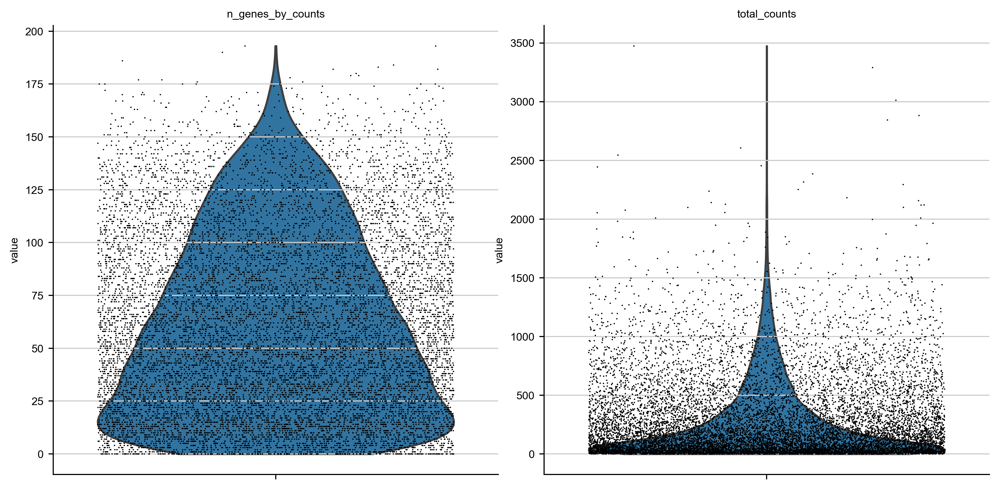

In [8]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

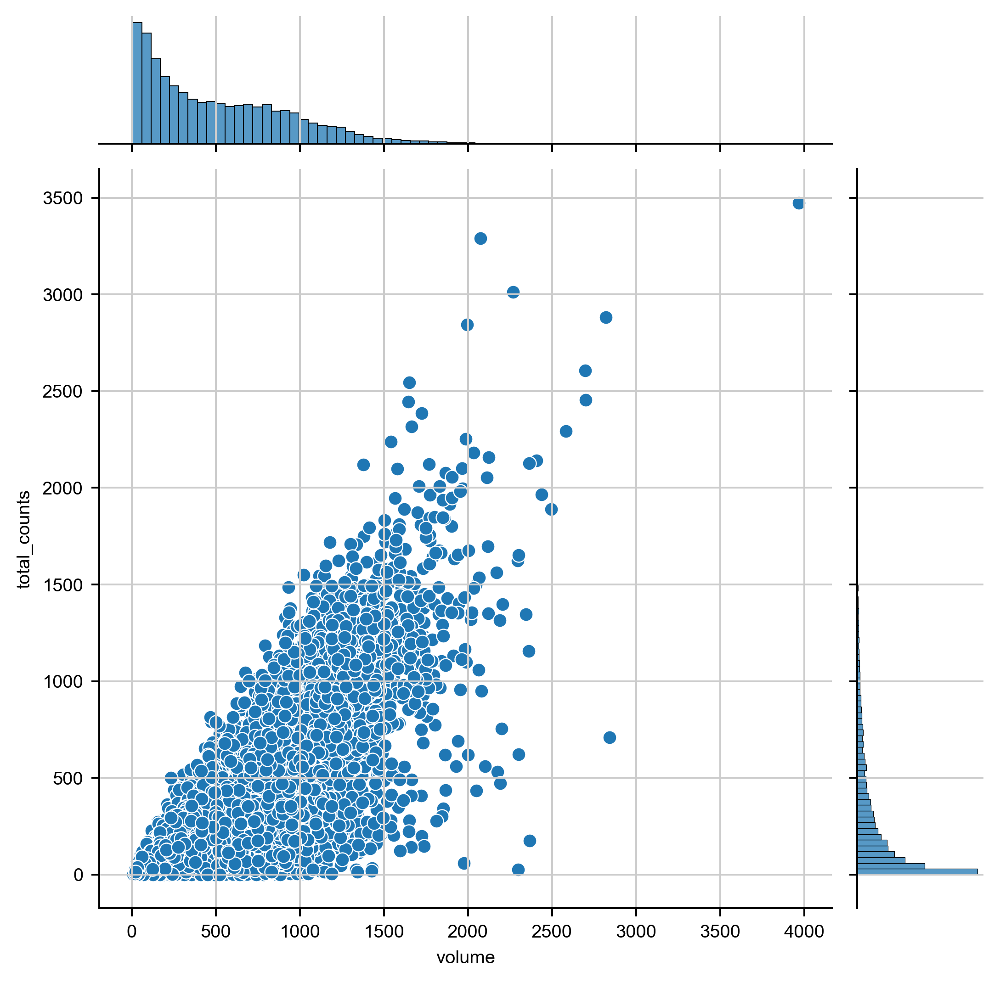

In [9]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

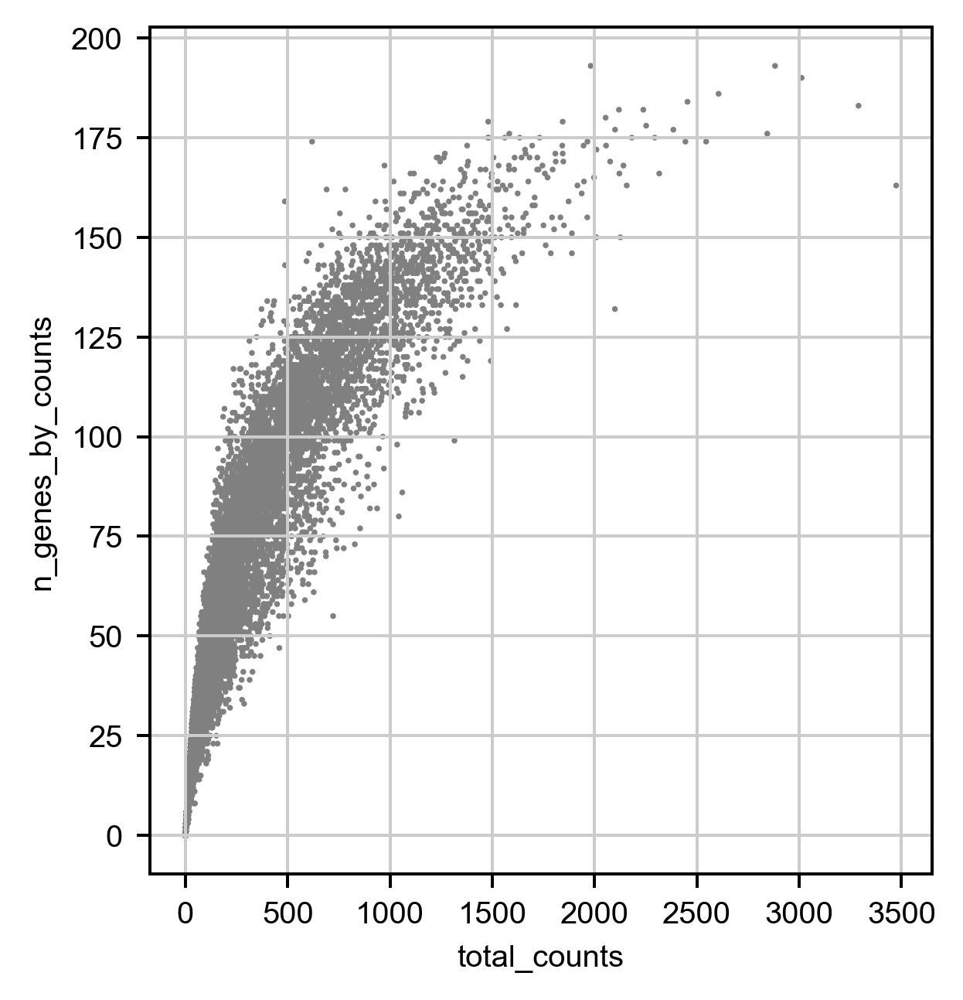

In [10]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [11]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
adata = adata[adata.obs['n_genes_by_counts'] > gene_count_threshold]
adata = adata[adata.obs['total_counts'] > total_count_threshold]
adata = adata[adata.obs['volume'] > volume_threshold]
adata = adata[adata.obs['volume'] <= volume_upper_threshold]

print(len(adata) / len(cell_meta_data) , len(adata))

0.762499060221036 10142


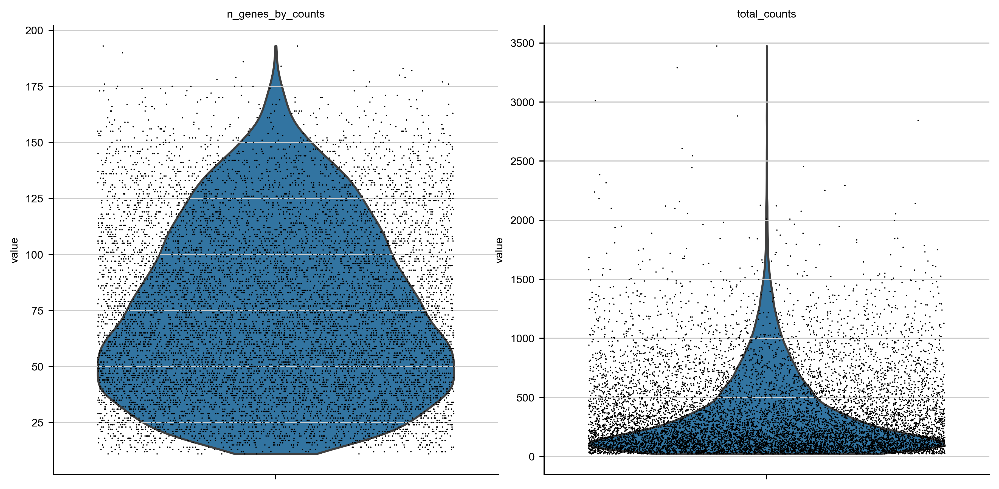

In [12]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [13]:
seg_model.eval?

Object `seg_model.eval` not found.


In [14]:
np.mean(adata.obs['total_counts'])

363.9578857421875

## 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


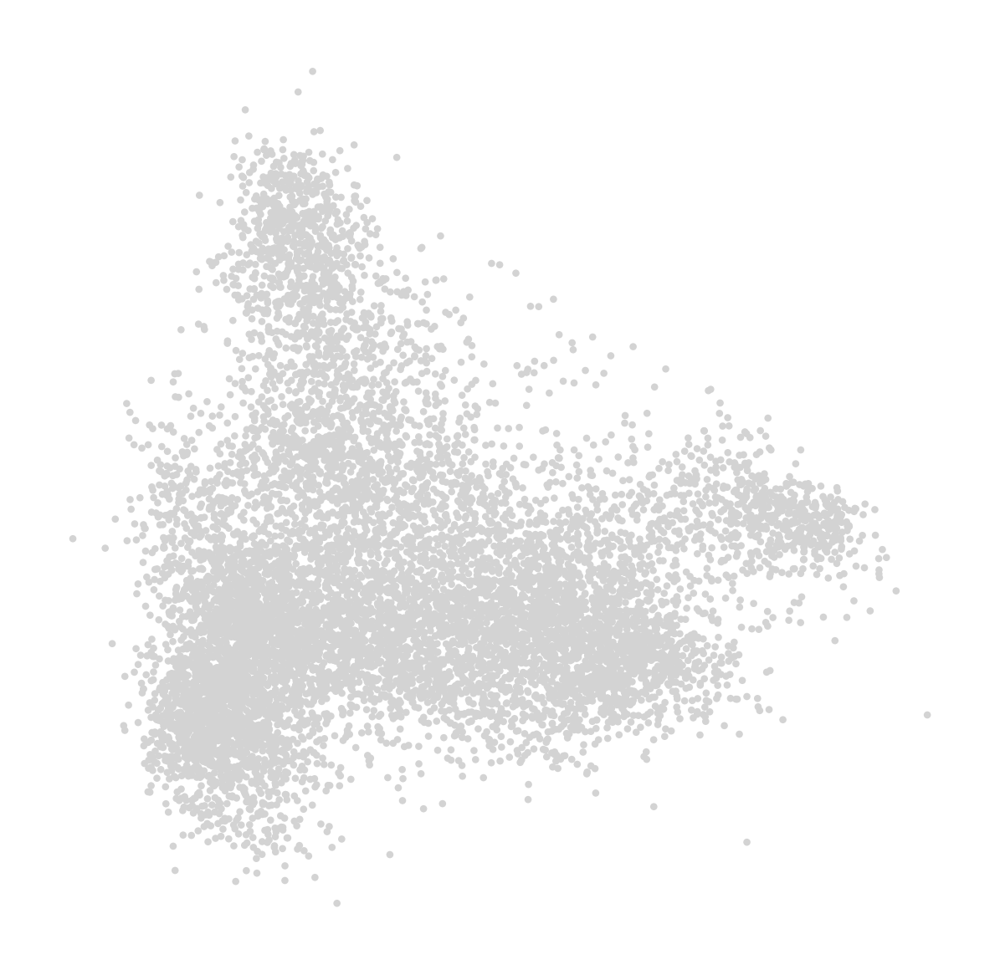

Wall time: 16.7 s


In [15]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [16]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

Wall time: 21.8 s


In [17]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=1)

Wall time: 701 ms


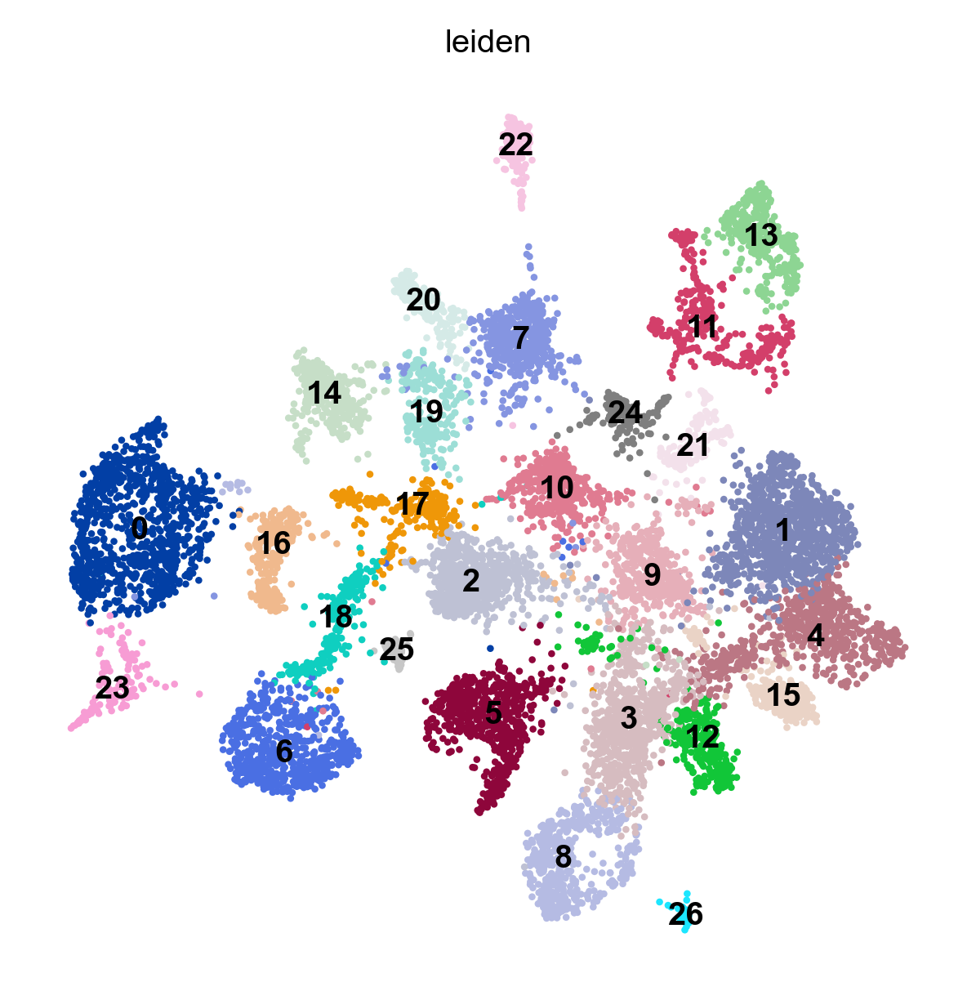

Wall time: 10.1 s


In [18]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

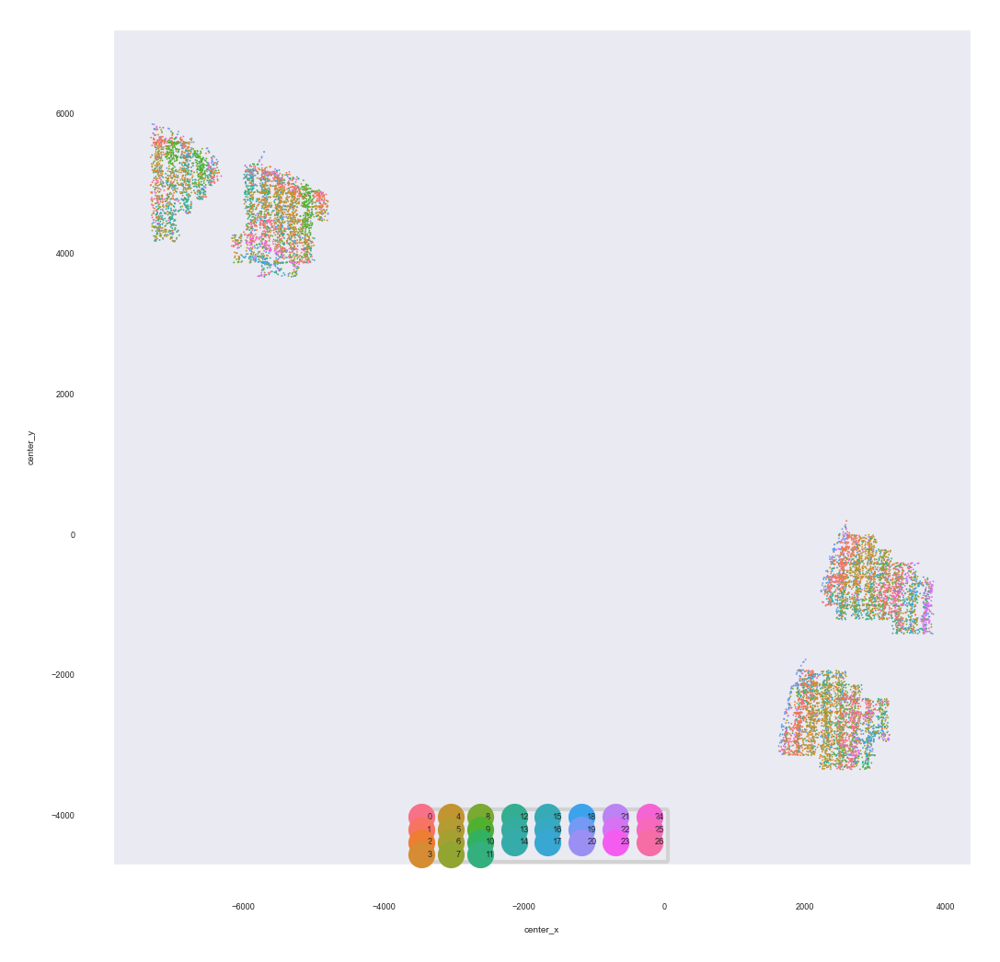

In [56]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
#plt.style.use('dark_background')
ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                hue='leiden', s=0.2, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])

## 5. Check count for each cell for genes of interest

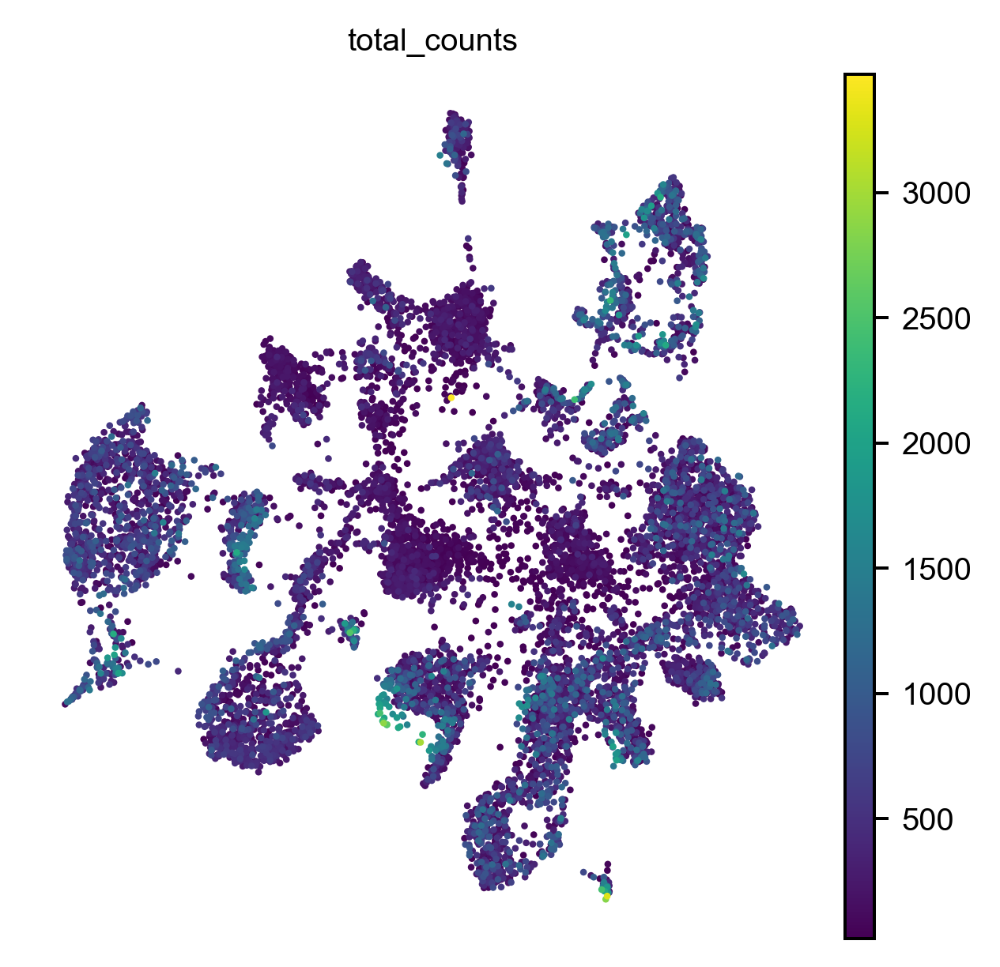

In [21]:
sc.pl.umap(adata, color='total_counts')

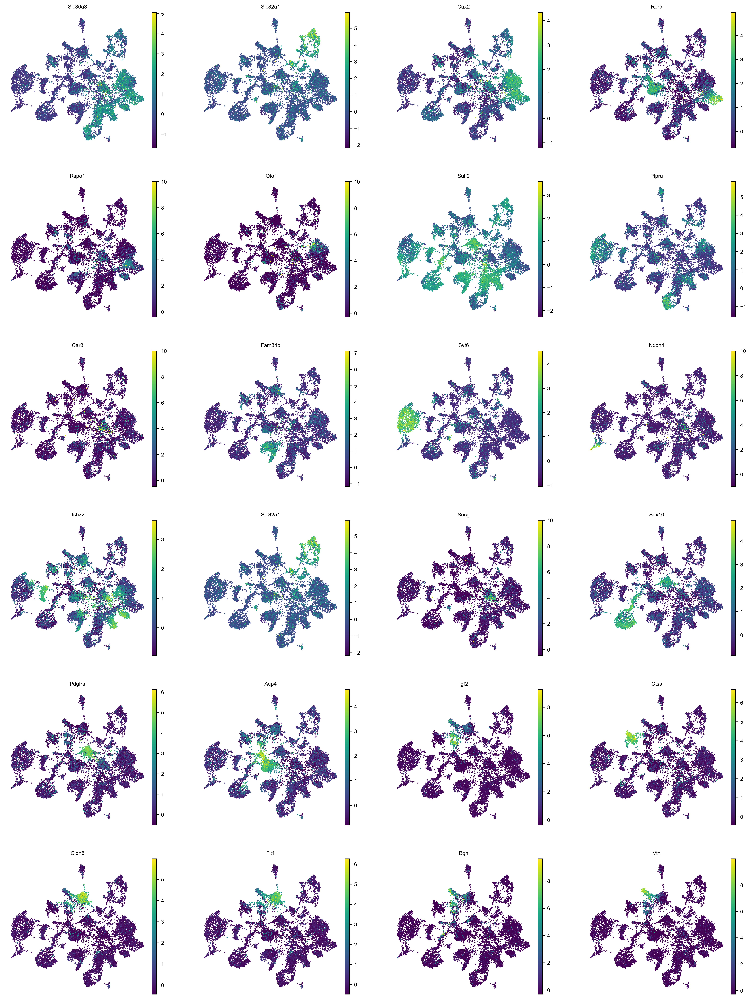

In [22]:
# Visualize marker genes
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Slc32a1', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in adata.var.index)]

sc.pl.umap(adata, color=marker_genes)

## 6.UMAP can be done using different settings and can be saved into different label column for cell type classifer use later

## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

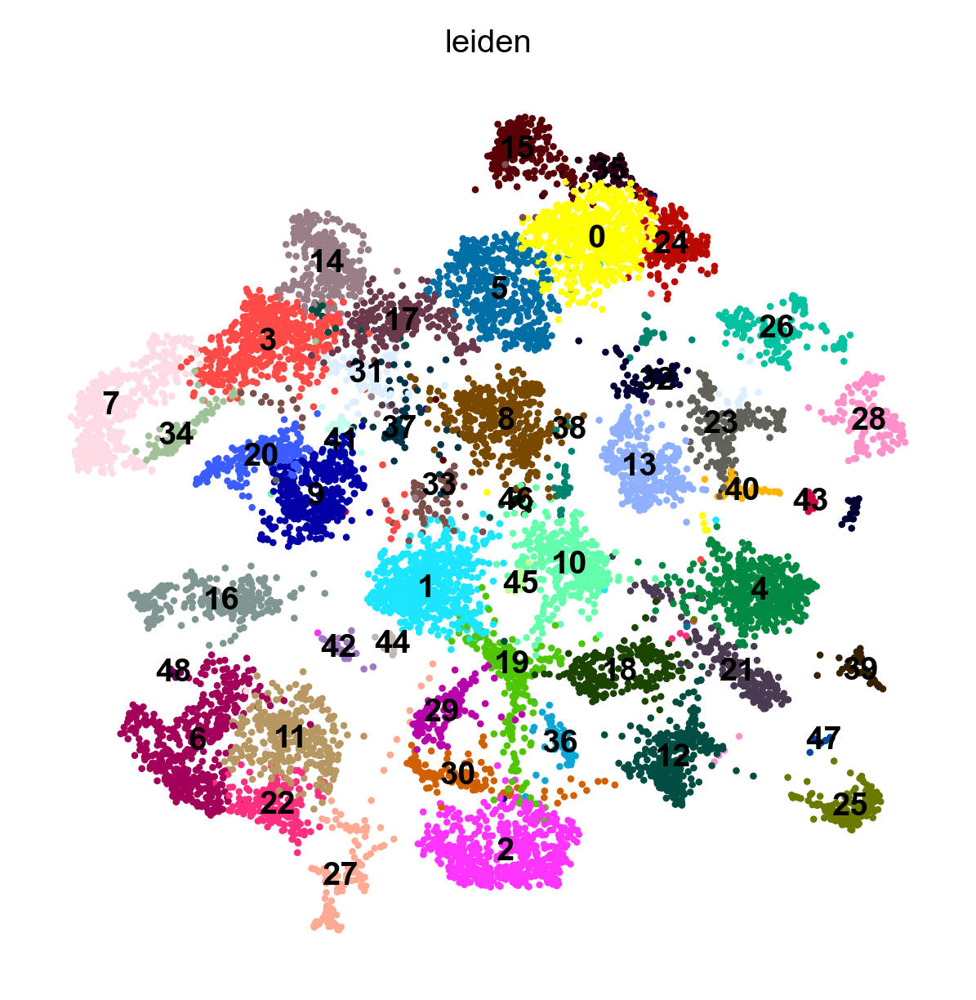

Wall time: 9.16 s


In [23]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=50)

sc.tl.leiden(adata, resolution=2)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this labels as a new column as 'leiden_cluster'
adata.obs['leiden_cluster'] = adata.obs.leiden

## 6.2 Use lower expected pcs and resolution to UMAP for cell-type distinction at subclass level

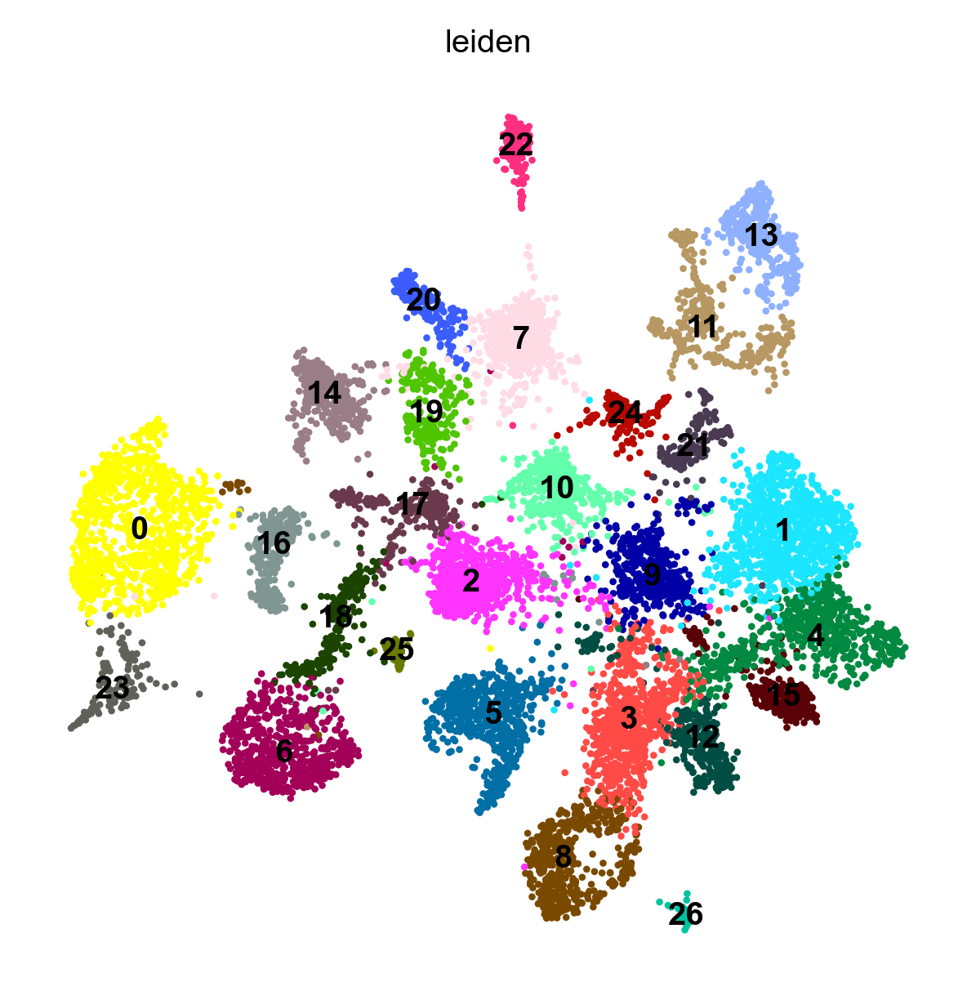

Wall time: 12.1 s


In [24]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(adata, resolution=1.)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
adata.obs['leiden_subclass'] = adata.obs.leiden

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [25]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'filtered_cluster_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\20220304-storm6_M1\PostAnalysis\filtered_cluster_data.h5ad


# 8. Cell type classifier

## 8.1 train classfier with Meng's dataset

In [26]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [27]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

In [28]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


## 8.2 train classfier with Meng's dataset

In [29]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(adata.var.index)))

In [30]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.
Wall time: 20min 9s


MLPClassifier(max_iter=500)

# 8.3 initial prediction

In [35]:
%run "..\..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib inline

In [36]:
import ImageAnalysis3.celltype_tools.classifier as clsf

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_20232/3359970815.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


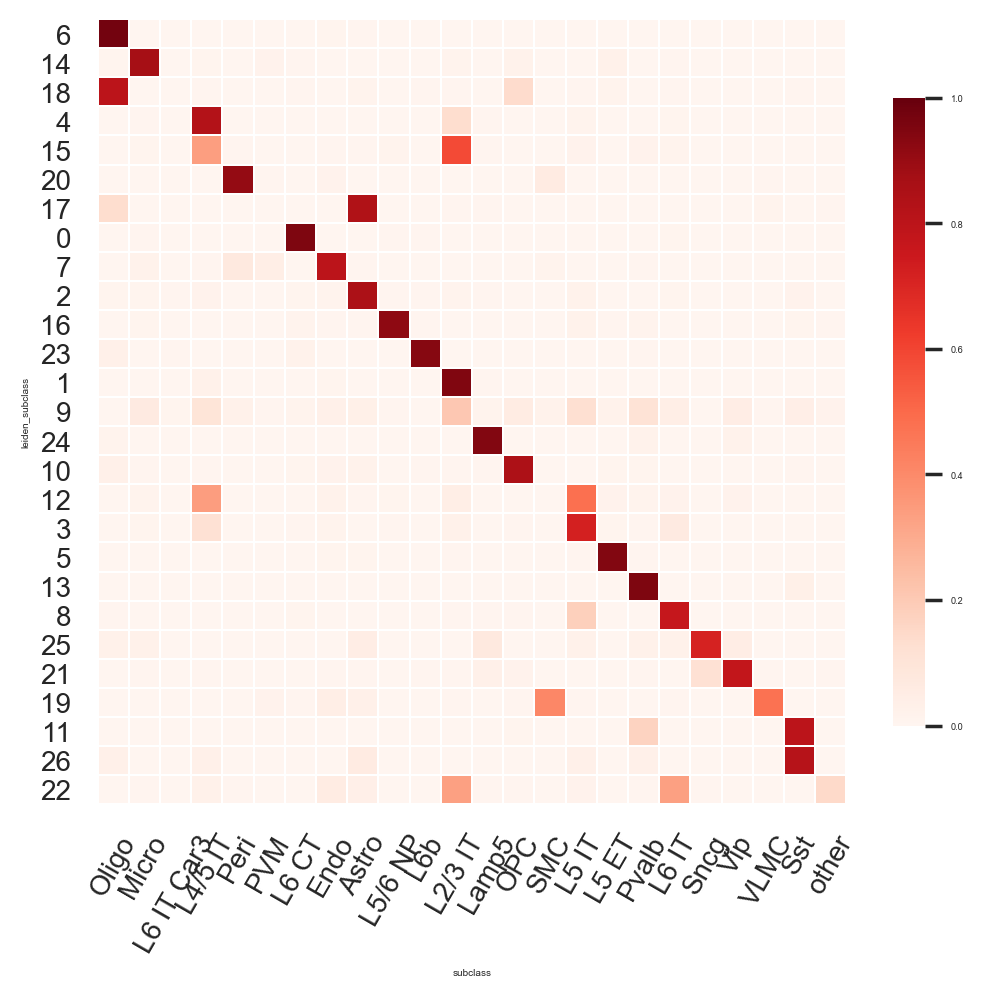

In [37]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5),dpi=100)
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

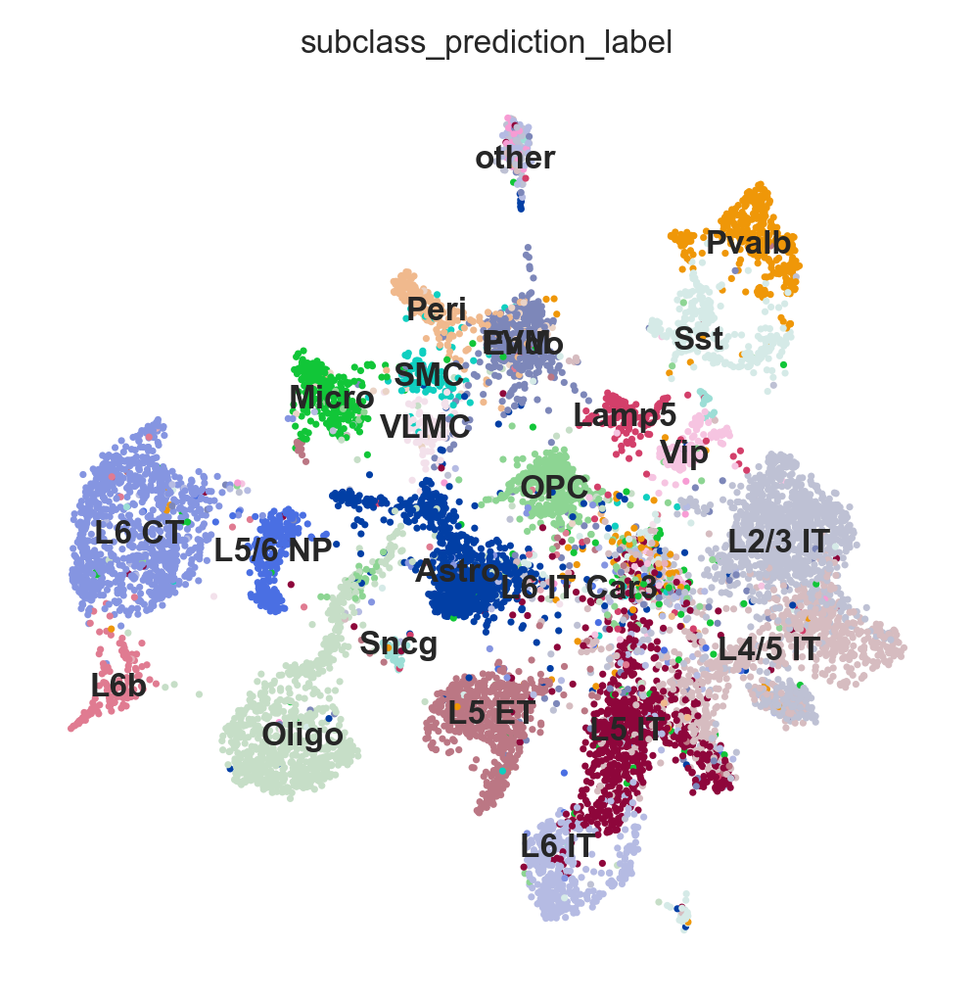

In [38]:
sc.settings.n_jobs = 24
sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.pl.umap(adata, color='subclass_prediction_label', legend_loc='on data')

### plot clustering as ref

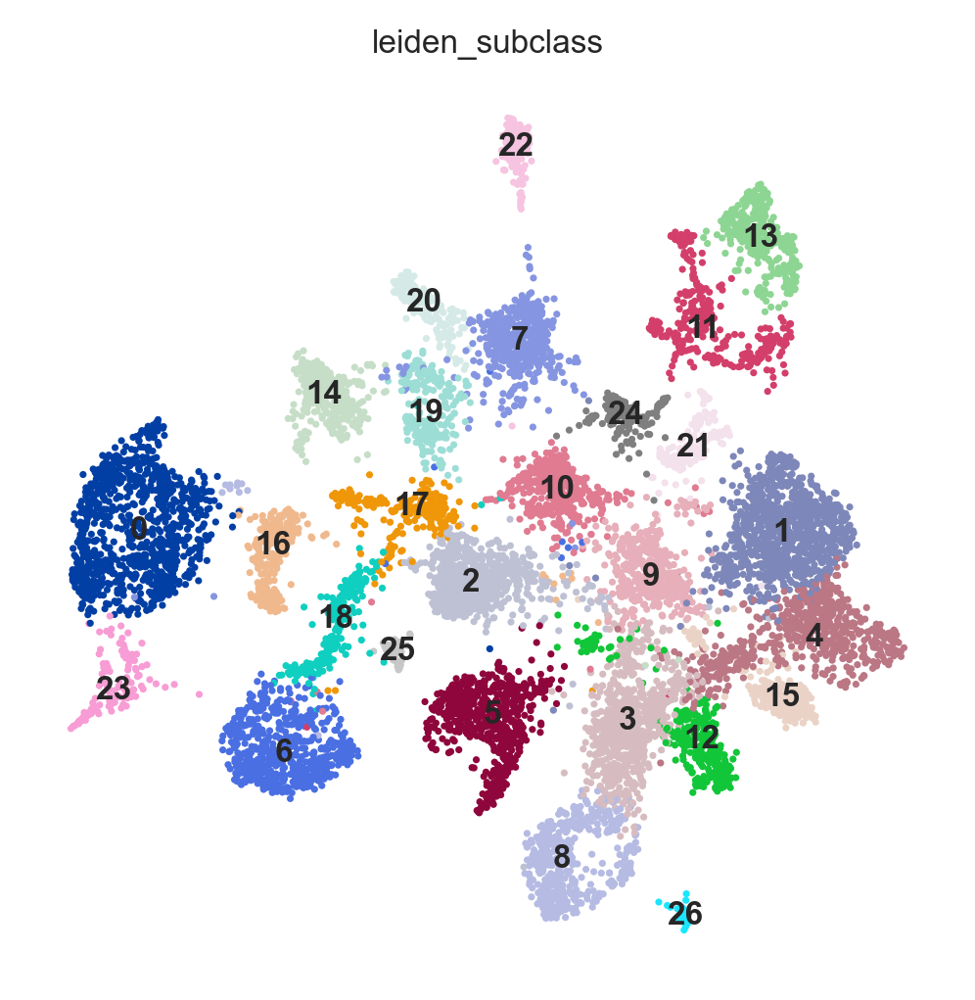

In [39]:
sc.pl.umap(adata, color='leiden_subclass', legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [40]:
adata.obs['leiden_subclass_sub'] = adata.obs['leiden_subclass'] 
# manual split
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['12']), key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['15']), key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['19']), key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['22']), key_added='leiden_subclass_sub')


#sc.tl.leiden(adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['16,1']), key_added='leiden_subclass_sub')
#sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,0']), key_added='leiden_subclass_sub')
#sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,2']), key_added='leiden_subclass_sub')

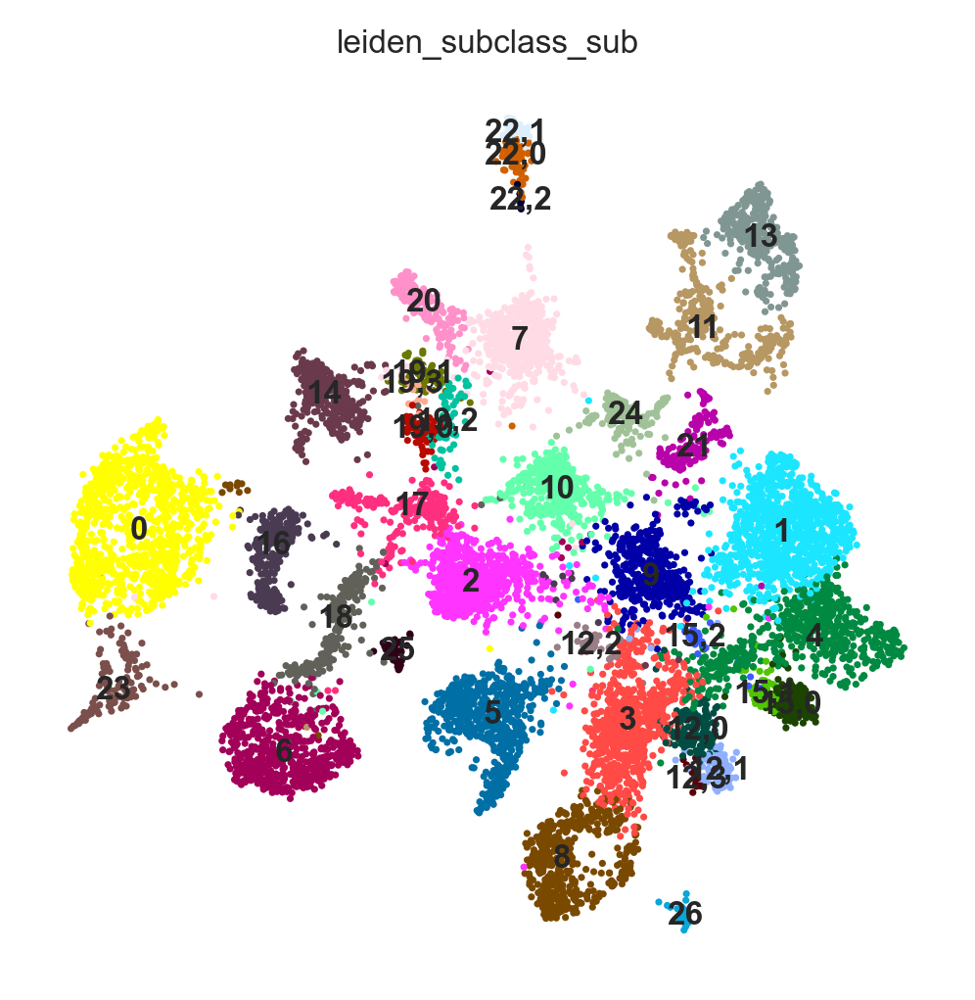

In [41]:
sc.pl.umap(adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_20232/393918492.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


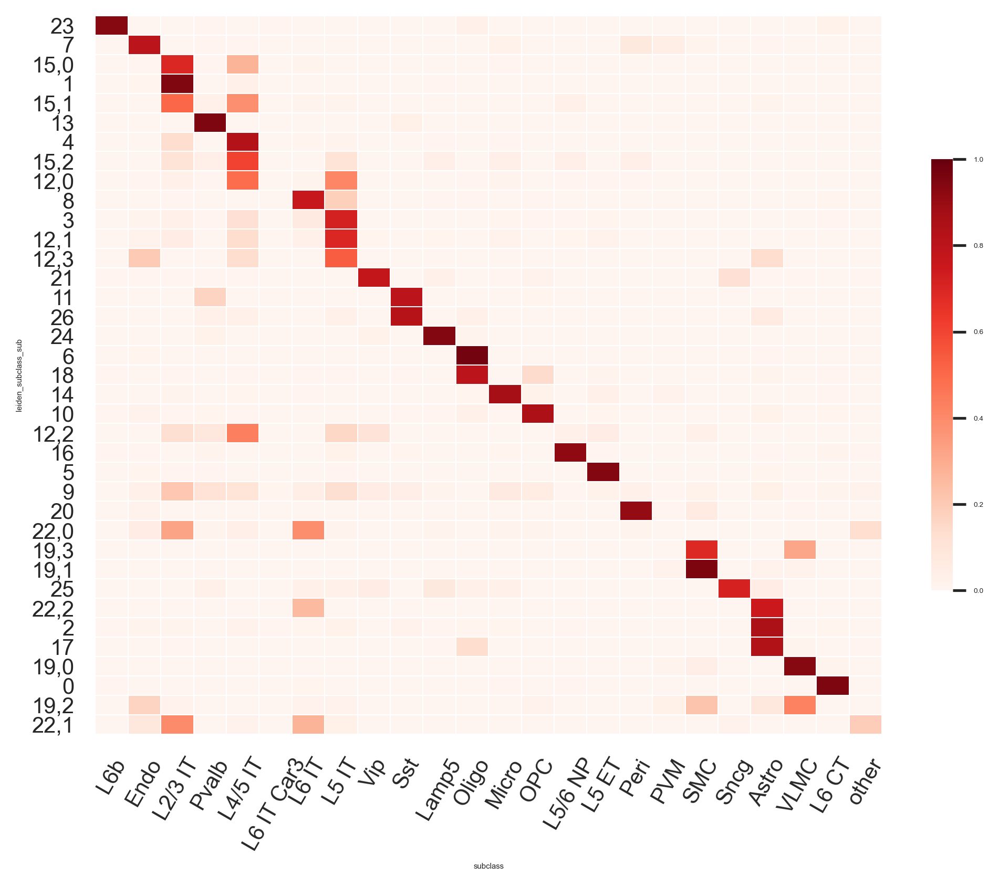

In [42]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass_sub'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (8,6))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [43]:
first_assign_dict = {}
missed_classes = []
# Automatic assign best fit if applicable
assign_th = 0.6
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]
    else:
        missed_classes.append(_cluster)

0 L6 CT
1 L2/3 IT
2 Astro
3 L5 IT
4 L4/5 IT
5 L5 ET
6 Oligo
7 Endo
8 L6 IT
10 OPC
11 Sst
12,1 L5 IT
13 Pvalb
14 Micro
15,0 L2/3 IT
15,2 L4/5 IT
16 L5/6 NP
17 Astro
18 Oligo
19,0 VLMC
19,1 SMC
19,3 SMC
20 Peri
21 Vip
22,2 Astro
23 L6b
24 Lamp5
25 Sncg
26 Sst


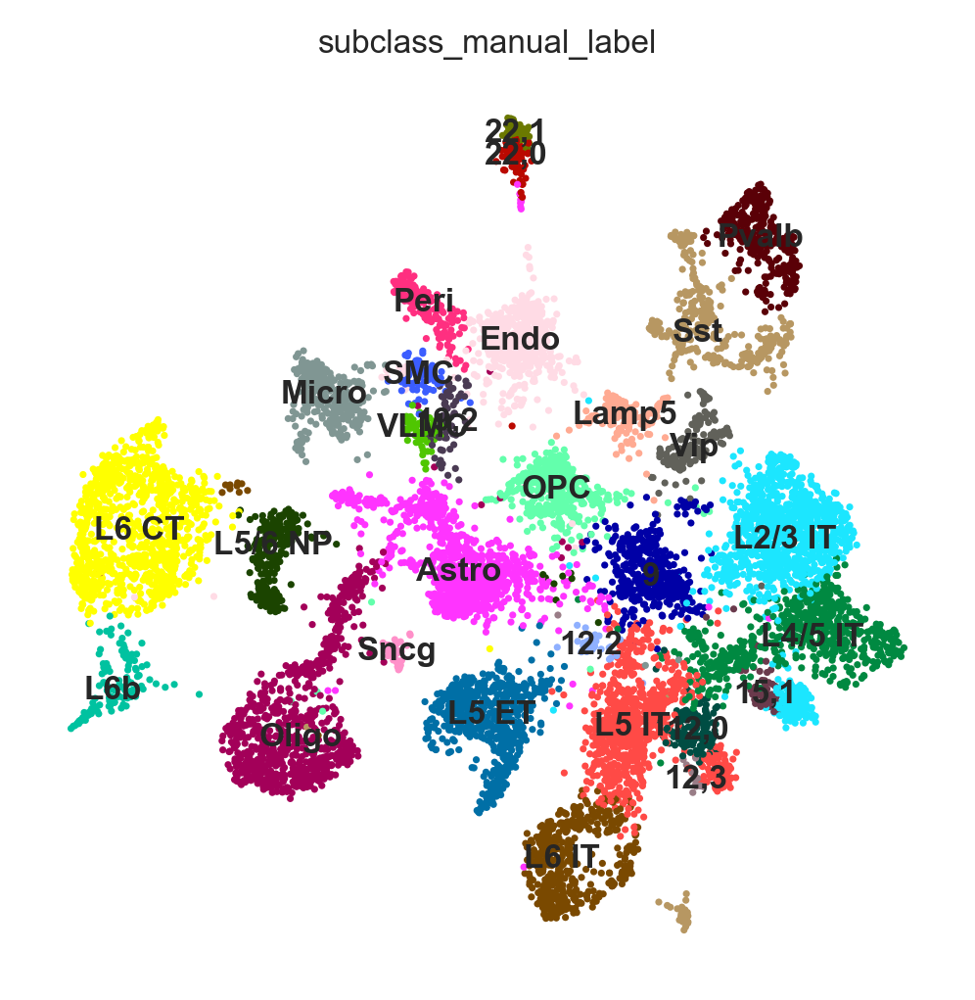

In [44]:
sc.settings.n_jobs = 24
sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

adata.obs['subclass_manual_label'] = adata.obs['leiden_subclass_sub'] 
adata.obs = adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

## 8.7 Manual assign leftovers

In [45]:
missed_classes

['9', '12,0', '12,2', '12,3', '15,1', '19,2', '22,0', '22,1']

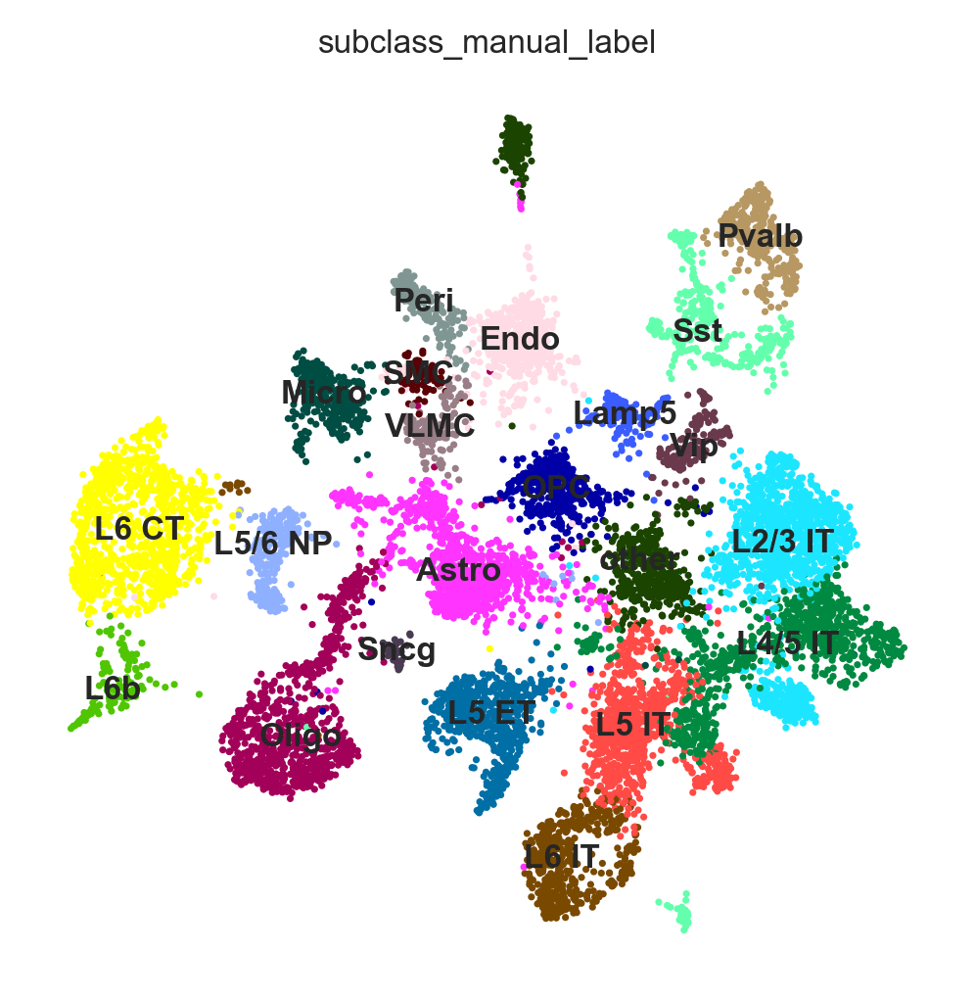

In [51]:
adata.obs = adata.obs.replace({'subclass_manual_label':{'12,0':'L4/5 IT', '12,2':'L4/5 IT'}})
adata.obs = adata.obs.replace({'subclass_manual_label':{'12,3':'L5 IT', }})
adata.obs = adata.obs.replace({'subclass_manual_label':{'15,1':'L2/3 IT',}})
adata.obs = adata.obs.replace({'subclass_manual_label':{'19,2':'VLMC',}})

adata.obs = adata.obs.replace({'subclass_manual_label':{'9':'other', '22,0':'other', '22,1':'other'}})

#adata.obs = adata.obs.replace({'subclass_manual_label':{'25,1':'L6 CT'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'27,0':'L5 ET'}})

np.unique(adata.obs['subclass_manual_label'])

sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp/ipykernel_20232/1525045723.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


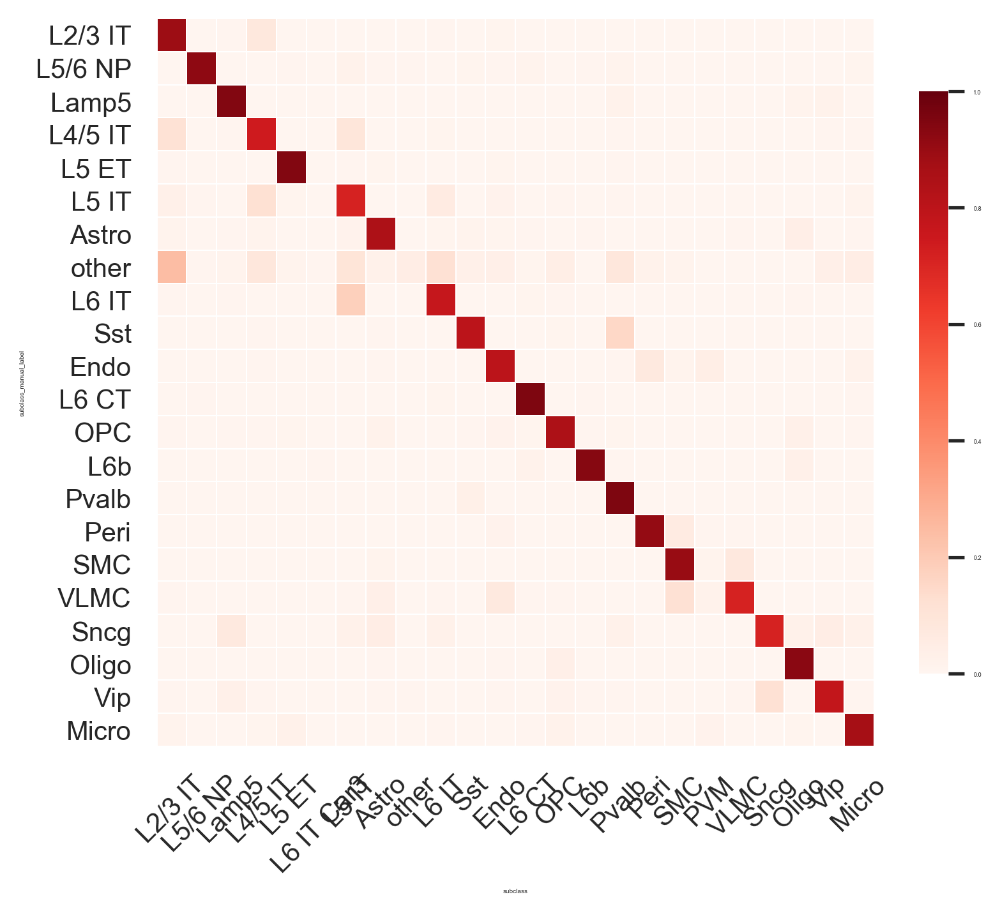

In [52]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {query_cluster_column}')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.2)

sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

# 10. Save manually labeled data

In [53]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\20220304-storm6_M1\PostAnalysis\manual_labeled_data.h5ad
